# The evolution of opendata.swiss

This notebooks contains a quick analysis of data we have been collecting on the datasets available on [opendata.swiss](https://opendata.swiss). Data collection was done by a crawler more or less regularly. Each time the cralwer attemted to downoad the data in each dataset and analyze it.

In [2]:
import pandas as pd
from pdvega import Axes
import pdvega

In [3]:
from pandas.io.json import json_normalize
import json

## Setup

In [4]:
def reader(path):
    date = path.split("_")[0]
    with open("../output/"+path) as f:
        a = json.load(f)
        a = json_normalize(a, ['downloads'], ['description', 'id', 'name', ['organization', 'name'], 'tags'])
    b = pd.DataFrame(a)
    print(len(b))
    b["date"] = pd.to_datetime(date)
    return b

## Importing the data

In [5]:
li = list(map(reader, ["20171031_opendata.swiss.datasets.json",
                  "20180322_opendata.swiss.datasets.json",
                  "20180818_opendata.swiss.datasets.json",
                  "20180704_opendata.swiss.datasets.json",
                  "20180906_opendata.swiss.datasets.json",
                  "20181031_opendata.swiss.datasets.json",
                  "20181107_opendata.swiss.datasets.json",
                  "20181128_opendata.swiss.datasets.json",
                  "20190109_opendata.swiss.datasets.json",
                  "20190504_opendata.swiss.datasets.json",
                  "20190508_opendata.swiss.datasets.json",
                  "20190529_opendata.swiss.datasets.json",
                  "20190605_opendata.swiss.datasets.json",
                  "20190619_opendata.swiss.datasets.json"
                 ]))

4590
9577
23483
23299
23786
23921
24011
24126
24583
26785
26802
26944
26988
27064


In [6]:
ods = pd.concat(li)
ods.rename({"organization.name": "organization"}, axis=1, inplace=True)

In [7]:
top = ods.groupby(["date", "id"]).first().reset_index()
top.head()

,date,id,content_type,created,dimensions,dl_error,file_size,filepath,format,issued,...,rights,size,status,status_code,total,url,description,name,organization,tags
0,2017-10-31,1-personenhaushalte-anz,text/csv,2017-09-25T08:57:31.954159,"{'rows': 1566, 'columns': 12}",None,213844,/Users/jonas/Desktop/opendata_swiss_crawler/data,CSV,2016-01-21T17:30:35,...,NonCommercialAllowed-CommercialAllowed-Referen...,NaN,Analyzed,200.0,18792,http://www.web.statistik.zh.ch/ogd/data/KANTON...,Anzahl Einpersonenhaushalte (Privathaushalte),1-Personenhaushalte [Anz.],Statistisches Amt Kanton Zürich,[population]
1,2017-10-31,15-jahresverbrauch,text/csv,2017-09-25T09:00:50.839265,"{'rows': 3908, 'columns': 12}",None,495523,/Users/jonas/Desktop/opendata_swiss_crawler/data,CSV,2016-01-21T17:30:35,...,NonCommercialAllowed-CommercialAllowed-Referen...,NaN,Analyzed,200.0,46896,http://www.web.statistik.zh.ch/ogd/data/KANTON...,Verbrauchte Bauzonenfläche der letzten 15 Jahr...,15-Jahresverbrauch [%],Statistisches Amt Kanton Zürich,[construction]
2,2017-10-31,15-jahresverbrauch-ha,text/csv,2017-09-25T09:00:04.545114,"{'rows': 3908, 'columns': 12}",None,504351,/Users/jonas/Desktop/opendata_swiss_crawler/data,CSV,2016-01-21T17:30:35,...,NonCommercialAllowed-CommercialAllowed-Referen...,NaN,Analyzed,200.0,46896,http://www.web.statistik.zh.ch/ogd/data/KANTON...,Verbrauchte Bauzonenfläche der letzten 15 Jahre,15-Jahresverbrauch [ha],Statistisches Amt Kanton Zürich,[construction]
3,2017-10-31,19th-century-decisions-of-the-government-counc...,application/octet-stream,2017-07-26T00:04:09.462081,{},None,279127397,/Users/jonas/Desktop/opendata_swiss_crawler/data,ZIP,2017-06-01T02:00:00,...,NonCommercialAllowed-CommercialAllowed-Referen...,NaN,Analyzed,200.0,5,https://zenodo.org/record/803239/files/TKR_RRB...,Transkriptionen der handschriftlichen Einzelbe...,Zürcher Regierungsratsbeschlüsse des 19. Jahrh...,OpenGLAM CH Working Group,"[administration, agriculture, trade, construct..."
4,2017-10-31,2-personenhaushalte-anz,text/csv,2017-09-25T08:57:38.942867,"{'rows': 1566, 'columns': 12}",None,214055,/Users/jonas/Desktop/opendata_swiss_crawler/data,CSV,2016-01-21T17:30:35,...,NonCommercialAllowed-CommercialAllowed-Referen...,NaN,Analyzed,200.0,18792,http://www.web.statistik.zh.ch/ogd/data/KANTON...,Anzahl Zweipersonenhaushalte (Privathaushalte),2-Personenhaushalte [Anz.],Statistisches Amt Kanton Zürich,[population]


In [8]:
len(top[top.date == "2019-05-08"])

6827

In [9]:
len(top[top.date == "2019-05-04"])

6823

## 1. Datasets

We start by inspecting how the number of datasets on the platform has evolved. Expect for a jump in 2018, the growth has been relatively steady.

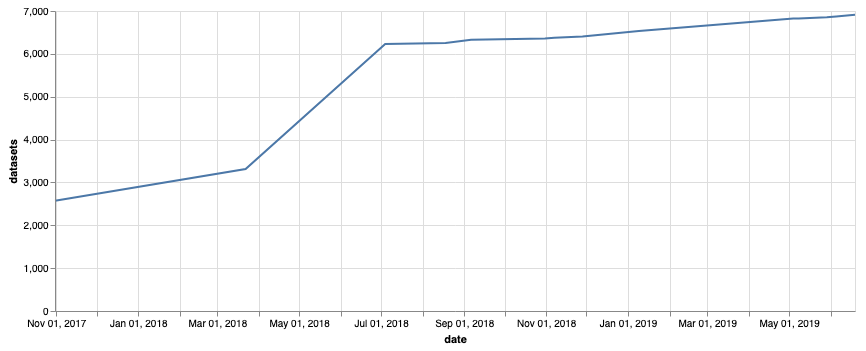

In [42]:
datasets1 = top.groupby(["date"]).id.count().to_frame().reset_index()
Axes({
   "mark": "line",
    "encoding": {
        "x": {
            "field": "date",
            "type": "temporal"
        },
        "y": {
            "field": "id",
            "type": "quantitative",
            "axis": {"title": "datasets"}
        }
    },
    "width": 800,
    "height": 300
}, datasets1)

## 2. Datasets by Organization

Different organizations publish datasets. Yet it is the FSO who is responsible for most of the growth of the platform in the last year. When zooming in, other organizations who have contributed to the growth become visible such as Geoinformation Kanton Zürich and Kanton Basel-Stadt.


In [11]:
orgas = top.groupby(["organization", "date"]).id.count().to_frame().reset_index()

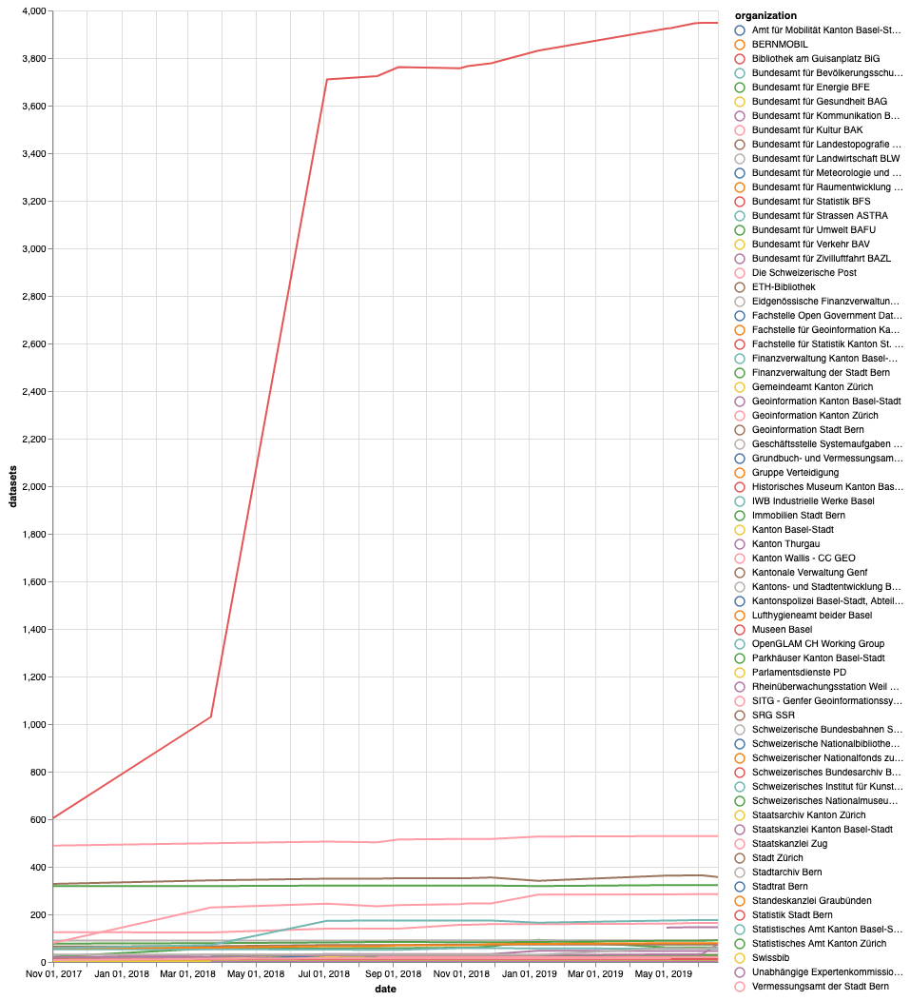

In [44]:
Axes({
    "mark": "line",
    "selection": {
        "a": {
            "type": "interval",
            "bind": "scales",
            "encodings": ["y"]
        }
    },
    "encoding": {
        "x": {
            "field": "date",
            "type": "temporal"
        },
        "y": {
            "field": "id",
            "type": "quantitative",
            "axis": {"title": "datasets"}
        },
        "color": {
            "field": "organization",
            "type": "nominal"
        },
        "tooltip": {
            "field": "organization",
            "type": "nominal" 
        }
    },
         "width": 700,
        "height": 1000
}, orgas)

## 3 File size over time

Interestingly the jump in newly provided FSO datasets in 2018 didn't affect the total file size so much. This is mostly because the FSO doesn't provide a large quantitiy of data compared to the City of Zürich or the SBB for example. For some organizations there are some strange spikes to the bottom at the end of November 2018. This might be due to data collection issues and no represent the reality.

In [50]:
ods.loc[ods.file_size == "undefined", "file_size"] = 0

/usr/local/lib/python3.7/site-packages/pandas/core/ops.py:1649: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = method(y)


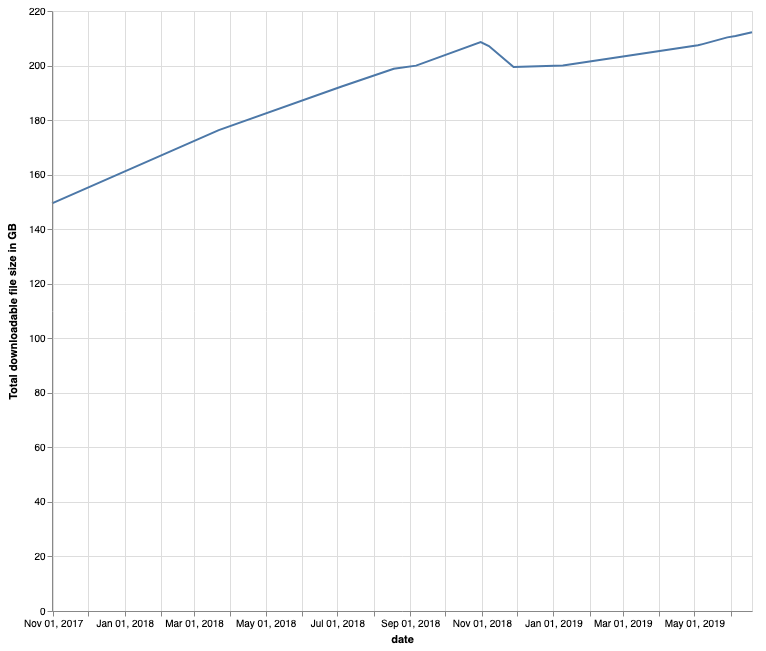

In [69]:
filesize3 = ods.groupby("date").file_size.sum().reset_index()
filesize3.file_size = filesize3.file_size / 1000 / 1000 / 1000
Axes({
    "mark": "line",
    "encoding": {
        "x": {
            "field": "date",
            "type": "temporal"
        },
        "y": {
            "field": "file_size",
            "type": "quantitative",
            "axis": {"title": "Total downloadable file size in GB"}
        }
    },
    "height": 600,
    "width": 700
}, filesize3)

In [73]:
fs_orga = ods.groupby(["date", "organization"]).file_size.sum().to_frame().reset_index()
fs_orga.file_size = fs_orga.file_size / 1000 / 1000 / 1000
fs_orga.groupby("organization")["file_size"].max().sort_values(ascending=False).head()

organization
Stadt Zürich                                                 116.824499
Geschäftsstelle Systemaufgaben Kundeninformation (SBB AG)     35.860800
Schweizerische Nationalbibliothek NB                          18.911305
Bundesamt für Statistik BFS                                   10.516334
Bundesamt für Landestopografie swisstopo                       9.532362
Name: file_size, dtype: float64

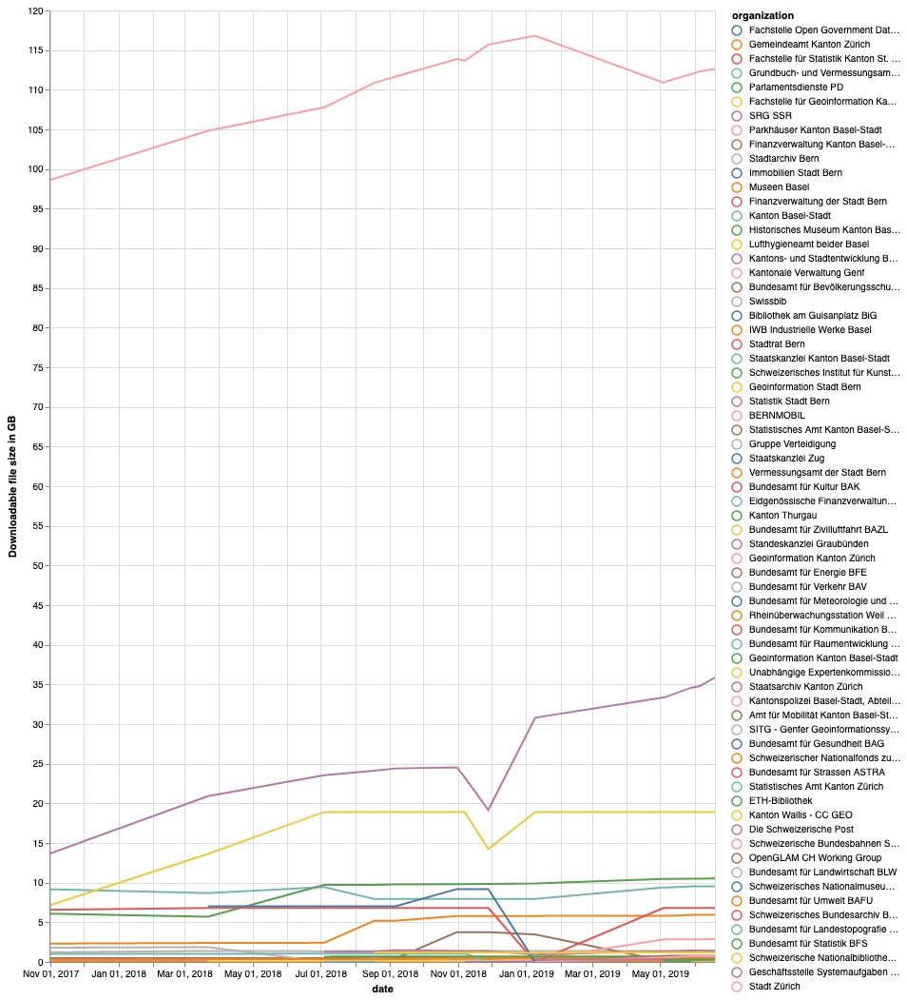

In [74]:
Axes({
    "mark": "line",
    "selection": {
        "a": {
            "type": "interval",
            "bind": "scales",
            "encodings": ["y"]
        }
    },
    "encoding": {
        "x": {
            "field": "date",
            "type": "temporal"
        },
        "y": {
            "field": "file_size",
            "type": "quantitative",
            "axis": {"title": "Downloadable file size in GB"}
        },
        "color": {
            "field": "organization",
            "type": "nominal",
            "sort": {"field": "file_size", "op": "sum"}
        },
        "tooltip": {
            "field": "organization",
            "type": "nominal" 
        }
    },
         "width": 700,
        "height": 1000
}, fs_orga)

## 4. Status Codes

The amount of datasets with non-200 status codes has remained fairly stable over the last year

In [85]:
status4 = ods.groupby(["date", "status_code"]).id.count().reset_index()
status4.head()

,date,status_code,id
0,2017-10-31,200.0,4529
1,2017-10-31,403.0,37
2,2017-10-31,404.0,12
3,2017-10-31,500.0,7
4,2017-10-31,502.0,2


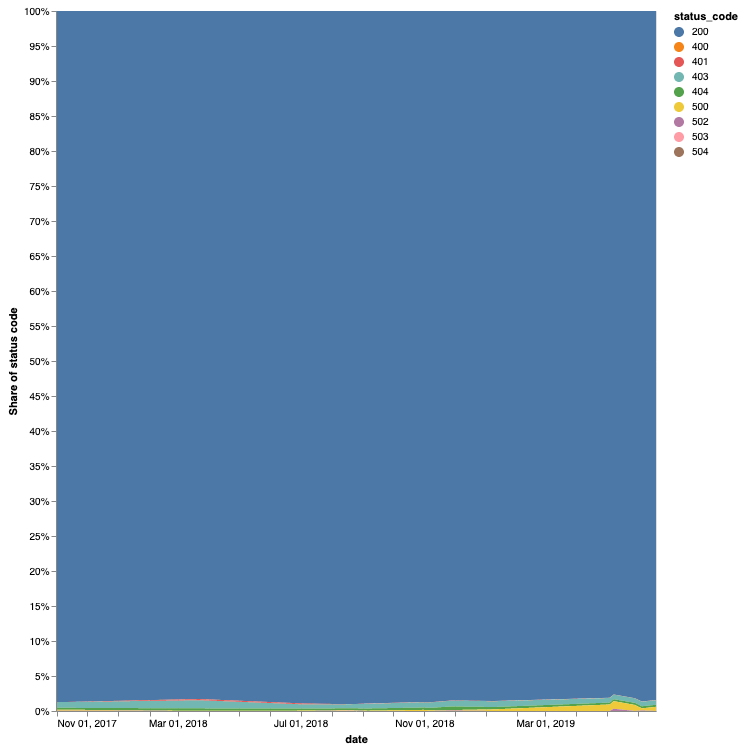

In [89]:
Axes({
  "mark": "area",
        "selection": {
        "a": {
            "type": "interval",
            "bind": "scales",
            "encodings": ["y"]
        }
    },
  "encoding": {
    "x": {
        "field": "date", 
        "type": "temporal"
    },
    "color": {
        "field": "status_code", 
        "type": "nominal"
    },
    "y": {
        "field": "id", 
        "type": "quantitative",
        "stack": "normalize",
        "axis": {"title": "Share of status code", "format": ".0%"}
    },
     "tooltip": {
        "field": "status_code", 
        "type": "nominal"
    }   
  },
   "width": 600,
    "height": 700
}, status4)

Open question: Are the non-200 status codes mainly coming from certain organizations or are they equally distributed?

## Formats

A look at the evolution of dataset formats prominently shows a rise in `HTML`. This typically means that an organization has its own platform and doesn't provide a direct download link. These datasets also don't correctly appear in the statistics on the total size.

The disapearance of the PC-AXIS format, formerly provided by the FSO is also clearly visible.

In contrast to the [recommendations](https://5stardata.info/en/), more and more PDFs are being published and less CSVs. This may also be due to actors sharing data on the platform.

In [97]:
formats = ods.groupby(["date", "format"]).id.count().to_frame().reset_index()

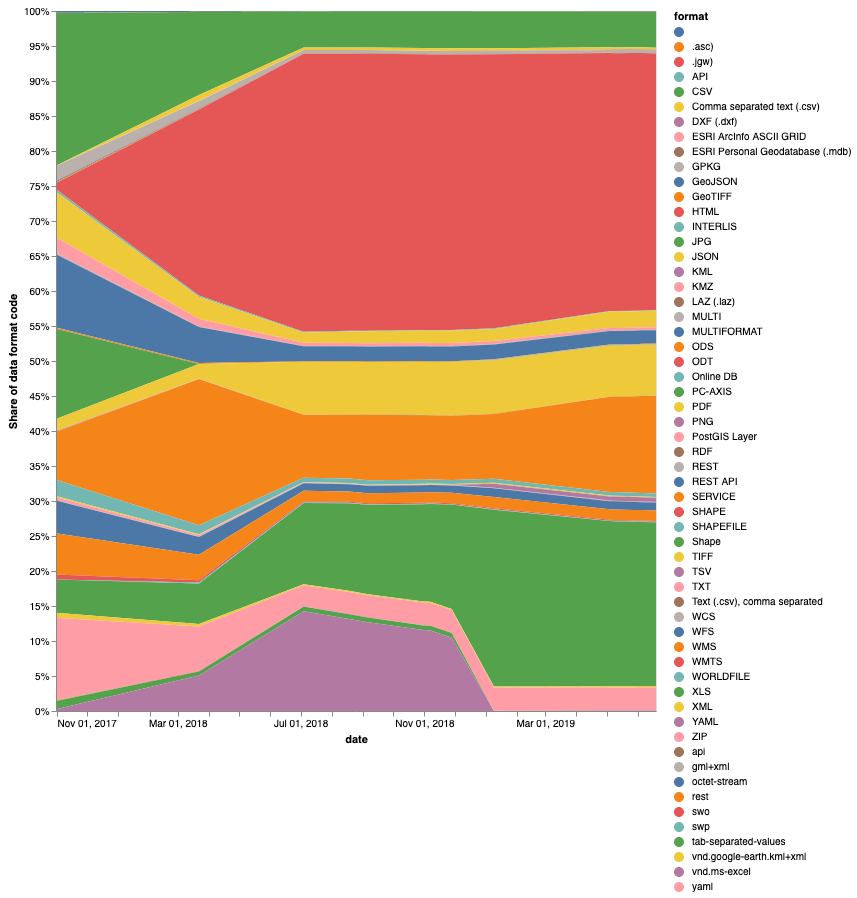

In [98]:
Axes({
  "mark": "area",
        "selection": {
        "a": {
            "type": "interval",
            "bind": "scales",
            "encodings": ["y"]
        }
    },
  "encoding": {
    "x": {
        "field": "date", 
        "type": "temporal"
    },
    "color": {
        "field": "format", 
        "type": "nominal"
    },
    "y": {
        "field": "id", 
        "type": "quantitative",
        "stack": "normalize",
        "axis": {"title": "Share of data format code", "format": ".0%"}
    },
     "tooltip": {
        "field": "format", 
        "type": "nominal"
    }   
  },
   "width": 600,
    "height": 700
}, formats)

## Descriptions

In [99]:
len(top[top.description.str.len() == 0]) / len(top)

0.4981926429938337

In [100]:
desc = top.groupby("date").apply(lambda d: d.description.str.len() == 0).to_frame().reset_index().rename({"level_1": "ct"}, axis=1)
descs = desc.groupby(["date", "description"]).count().reset_index()
descs.head()

,date,description,ct
0,2017-10-31,False,1970
1,2017-10-31,True,602
2,2018-03-22,False,2299
3,2018-03-22,True,1012
4,2018-07-04,False,2954


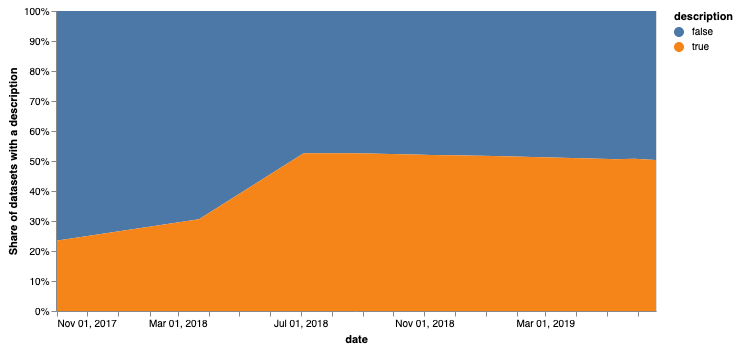

In [102]:
Axes({
  "mark": "area",
  "encoding": {
    "x": {
        "field": "date", 
        "type": "temporal"
    },
    "color": {
        "field": "description", 
        "type": "nominal"
    },
    "y": {
        "field": "ct", 
        "type": "quantitative",
        "stack": "normalize",
        "axis": {"title": "Share of datasets with a description", "format": ".0%"}
    },
     "tooltip": {
        "field": "description", 
        "type": "nominal"
    }   
  },
   "width": 600,
    "height": 300
}, descs)

## Terms of use

Recently a clear preference for the `Non commercial allowed, commercial with permission, reference required` terms of use can be seen. It is more strict than the previously most prevalent `Non commercial allowed, commercial allowed, reference required` terms of use.

In [25]:
lic = ods.groupby(["date", "rights"]).id.count().to_frame().reset_index()
lic.head()

,date,rights,id
0,2017-10-31,NonCommercialAllowed-CommercialAllowed-Referen...,1436
1,2017-10-31,NonCommercialAllowed-CommercialAllowed-Referen...,2623
2,2017-10-31,NonCommercialAllowed-CommercialWithPermission-...,1
3,2017-10-31,NonCommercialAllowed-CommercialWithPermission-...,454
4,2017-10-31,None,76


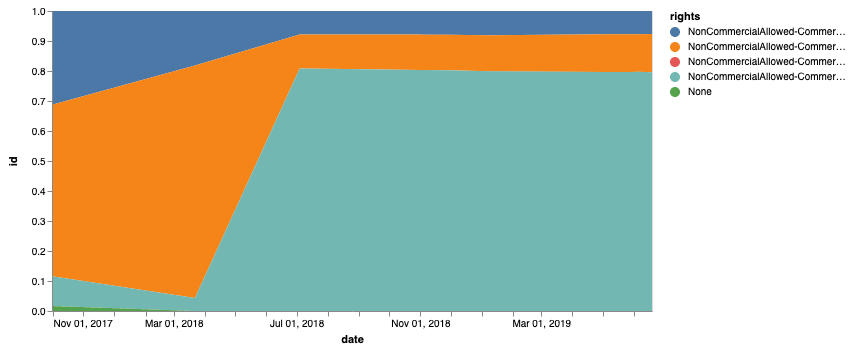

In [103]:
Axes({
  "mark": "area",
  "encoding": {
    "x": {
        "field": "date", 
        "type": "temporal"
    },
    "color": {
        "field": "rights", 
        "type": "nominal"
    },
    "y": {
        "field": "id", 
        "type": "quantitative",
        "stack": "normalize"
    },
     "tooltip": {
        "field": "rights", 
        "type": "nominal"
    }   
  },
   "width": 600,
    "height": 300
}, lic)

## Distributions of large files per organization

These distributions show that each organization has a certain profile when it comes to the variety of datasets the publish. Swisstopo as well as the city of Zürich have a ver large variety for example. Others like the BAG typically publsih files of very similar sizes. We take this as indicative, for the variety in content provided.

In [107]:
ds = ods[(ods.date > "2018-01-12") & (ods.file_size > 5000000)].copy()
ds["fs"] = ds.file_size / 1000000

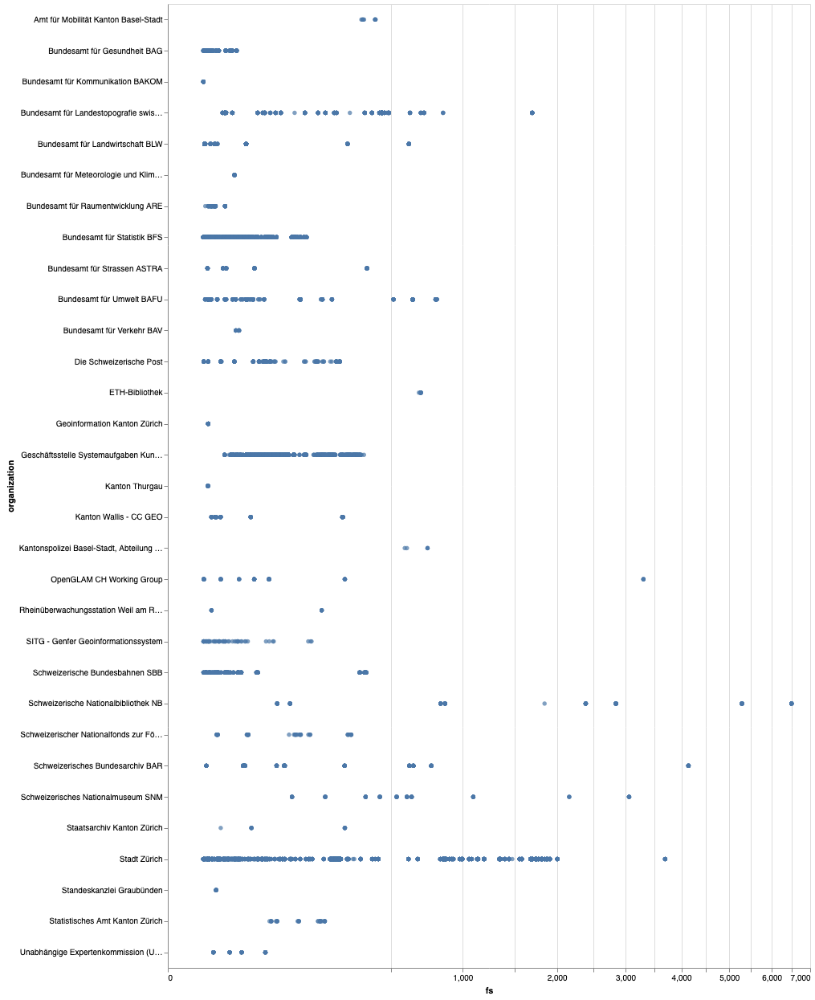

In [105]:
Axes({
  "mark": "circle",
  "encoding": {
    "y": {
        "field": "organization", 
        "type": "nominal"
    },
    "x": {
        "field": "fs", 
        "type": "quantitative",
        "scale": {"type": "pow", "exponent": "0.4"}
    },
     "tooltip": {
        "field": "name", 
        "type": "nominal"
    },
    "href": {
        "field": "url",
        "type": "nominal"
    }
  },
   "width": 800,
    "height": 1200
}, ds)

In [106]:
ods[(ods.date > "2018-01-12") & (ods.file_size > 10000000)].head()

,content_type,created,dimensions,dl_error,file_size,filepath,format,issued,modified,path,...,status,status_code,total,url,description,id,name,organization,tags,date
16,application/octetstream,2018-03-11T18:01:19.994949,{},None,289821349,/Users/jonas/Desktop/opendata_swiss_crawler/data,ZIP,2010-11-01T00:00:00,False,/Users/jonas/Desktop/opendata_swiss_crawler/da...,...,Analyzed,200.0,0,http://data.geo.admin.ch/ch.blw.erosion/data.zip,Erosionsrisikokarte der landwirtschaftlichen N...,__,"Erosionsrisikokarte der Schweiz, qualitativ 1 ...",Bundesamt für Landwirtschaft BLW,"[geography, territory]",2018-03-22
23,application/zip,2018-03-07T19:00:06.387887,"{'attributes': 4, 'points': 79751}",None,14759975,/Users/jonas/Desktop/opendata_swiss_crawler/data,MULTIFORMAT,2014-06-05T00:00:00,2017-12-06T00:00:00,/Users/jonas/Desktop/opendata_swiss_crawler/da...,...,Analyzed,200.0,319004,http://ge.ch/sitg/geodata/SITG/OPENDATA/5327/S...,Une des 5 classes d'entités constituant le mod...,__103,BASE DU BATIMENT 3D,SITG - Genfer Geoinformationssystem,"[geography, territory]",2018-03-22
24,application/zip,2018-03-07T19:04:45.690211,"{'attributes': 6, 'points': 79751}",None,31373205,/Users/jonas/Desktop/opendata_swiss_crawler/data,MULTIFORMAT,2014-06-05T00:00:00,2017-12-06T00:00:00,/Users/jonas/Desktop/opendata_swiss_crawler/da...,...,Analyzed,200.0,478506,http://ge.ch/sitg/geodata/SITG/OPENDATA/0587/S...,Une des 5 classes d'entités constituant le mod...,__104,FACADE DU BATIMENT 3D,SITG - Genfer Geoinformationssystem,"[geography, territory]",2018-03-22
29,application/zip,2018-03-07T19:03:11.164745,"{'attributes': 6, 'points': 314271}",None,27186033,/Users/jonas/Desktop/opendata_swiss_crawler/data,MULTIFORMAT,2012-12-17T00:00:00,2017-12-06T00:00:00,/Users/jonas/Desktop/opendata_swiss_crawler/da...,...,Analyzed,200.0,1885626,http://ge.ch/sitg/geodata/SITG/OPENDATA/0635/S...,"Emprises des toitures des bâtiments hors-sol, ...",__109,TOITS DES BATIMENTS,SITG - Genfer Geoinformationssystem,"[geography, territory]",2018-03-22
33,application/zip,2018-03-07T19:04:38.535828,"{'attributes': 6, 'points': 59104}",None,77215665,/Users/jonas/Desktop/opendata_swiss_crawler/data,MULTIFORMAT,2008-06-03T00:00:00,2017-12-06T00:00:00,/Users/jonas/Desktop/opendata_swiss_crawler/da...,...,Analyzed,200.0,354624,http://ge.ch/sitg/geodata/SITG/OPENDATA/3476/S...,Agrégation des 5 niveaux de la couverture du s...,__112,COUVERTURE DU SOL DOMAINE ROUTIER AGRÉGATION D...,SITG - Genfer Geoinformationssystem,"[geography, territory]",2018-03-22


## The end

This analysis has given a rough overview over the recent developments of opendata.swiss. Yet there is much more to discover in the data. If you want to dive in you'll find this notebook as well as all the data on [Github](https://github.com/jonasoesch/opendata_swiss_crawler_reborn)